In [ ]:
# https://drive.google.com/file/d/1DEEj3LdYYL8tf0CFjN-chKzSUr_lrRIU/view?usp=share_link
!gdown 1DEEj3LdYYL8tf0CFjN-chKzSUr_lrRIU

# https://drive.google.com/file/d/1YzBuNge95ntsu-AP1xuBVFJy1ki8aPqm/view?usp=sharing
!gdown 1YzBuNge95ntsu-AP1xuBVFJy1ki8aPqm

# https://docs.google.com/spreadsheets/d/1LtYAyztC3ZVDy-v0xO1uH279BkfgcnPg/edit?usp=share_link&ouid=117351453470675749663&rtpof=true&sd=true
!gdown 1LtYAyztC3ZVDy-v0xO1uH279BkfgcnPg

# https://docs.google.com/spreadsheets/d/1TBmBnASXMSYiWsRo1ppdUzMpEqRwPR3e/edit?usp=share_link&ouid=117351453470675749663&rtpof=true&sd=true
!gdown 1TBmBnASXMSYiWsRo1ppdUzMpEqRwPR3e

# https://drive.google.com/file/d/1itXNaTTMmvvexAG6l0wT-4723pqVynG7/view?usp=share_link
!gdown 1itXNaTTMmvvexAG6l0wT-4723pqVynG7

!unzip weights.zip -d weights

Downloading...
From: https://drive.google.com/uc?id=1DEEj3LdYYL8tf0CFjN-chKzSUr_lrRIU
To: /content/jkh_posts2_final.csv
100% 2.19M/2.19M [00:00<00:00, 140MB/s]
Downloading...
From: https://drive.google.com/uc?id=1YzBuNge95ntsu-AP1xuBVFJy1ki8aPqm
To: /content/weights.zip
100% 517k/517k [00:00<00:00, 162MB/s]
Downloading...
From: https://drive.google.com/uc?id=1LtYAyztC3ZVDy-v0xO1uH279BkfgcnPg
To: /content/закупки_v3_light.xlsx
100% 513k/513k [00:00<00:00, 92.3MB/s]
Downloading...
From: https://drive.google.com/uc?id=1TBmBnASXMSYiWsRo1ppdUzMpEqRwPR3e
To: /content/закупки_v4_light.xlsx
100% 606k/606k [00:00<00:00, 114MB/s]
Downloading...
From: https://drive.google.com/uc?id=1itXNaTTMmvvexAG6l0wT-4723pqVynG7
To: /content/candidates_posts_with_3.csv
100% 8.51M/8.51M [00:00<00:00, 71.3MB/s]
Archive:  weights.zip
  inflating: weights/1.npy           
  inflating: weights/10.npy          
  inflating: weights/11.npy          
  inflating: weights/12.npy          
  inflating: weights/13.npy   

In [ ]:
!pip install geopandas
!pip install h3
!pip install osmnx
!pip install folium
!pip install pygeos

# !pip install bertopic

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 15.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.4/16.4 MB 66.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.9/7.9 MB 123.3 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 3.2 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 95.5/95.5 kB 3.4 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 25.2 MB/s eta 0:00:00


In [ ]:
import os
import json
import math
from datetime import datetime

os.environ['USE_PYGEOS'] = '0'

import geopandas as gpd
import pandas as pd
import numpy as np
import json
import h3
import folium
import osmnx as ox
from shapely import wkt
from folium.plugins import MarkerCluster
from shapely.geometry import Polygon
from scipy import sparse
import torch

import matplotlib.pyplot as plt
import matplotlib as mpl

from tqdm.notebook import tqdm

tqdm.pandas()

import re

# from sentence_transformers import SentenceTransformer

# Работа с текстом

In [ ]:
zakupki_df = pd.read_excel('закупки_v4_light.xlsx', sheet_name='Лист1', dtype={'registrationNumber': 'object'})
zakupki_df = zakupki_df[zakupki_df.lati.notna()].copy()
zakupki_df['registrationNumber'] = zakupki_df['registrationNumber'].astype(str)
zakupki_df['num'] = range(len(zakupki_df))

In [ ]:
zakupki_df

,guid,registrationNumber,notice44,noticeNotPlacedByFz223p5s4,notice44Num,termination,urlEIS,createDateTime,publicationDate,contractDate,...,price,currency_code,startExecutionDate,endExecutionDate,address,yandex address,lati,long,comment,num
0,2147a5b4-a7dc-41a2-9b0b-a25e88d247d6,57805465516220002336768,False,False,NaN,False,https://lk.zakupki.gov.ru/223/contract/private...,2022-04-06 14:16:34,2022-04-06 14:25:09,2022-04-04,...,544088.41,RUB,2022-04-04,2022-04-30,ул. Лени Голикова д.53,"Россия, Санкт-Петербург, улица Лёни Голикова, 53",30.236843,59.840537,NaN,0
1,d3b3a317-5383-4244-b404-33671af86ab4,57801465635210000334848,False,False,NaN,False,https://lk.zakupki.gov.ru/223/contract/private...,2021-04-27 15:42:07,2021-04-27 15:48:33,2021-04-27,...,182151.35,RUB,2021-04-27,2021-08-31,"Морская наб., дом 15 литера А","Россия, Санкт-Петербург, Морская набережная, 15",30.212436,59.939978,NaN,1
2,93772bed-7d8d-4b1b-bf39-1c6a5f65244a,77811405931209996369920,False,False,32110005177 Выполнение работ по косметическому...,False,https://lk.zakupki.gov.ru/223/contract/private...,2021-03-01 17:46:06,2021-03-01 18:06:32,2021-02-24,...,426739.00,RUB,2021-02-24,2021-04-23,"ул. Антонова-Овсеенко, д. 5, корп.2, пар.1","Россия, Санкт-Петербург, улица Антонова-Овсеен...",30.460739,59.905773,NaN,2
3,393f5776-0a52-4daf-b522-4afeea66008c,57806386539220002930688,False,False,NaN,False,https://lk.zakupki.gov.ru/223/contract/private...,2022-06-22 08:27:27,2022-06-23 19:13:08,2022-06-21,...,870458.40,RUB,2022-06-21,2022-09-23,"г. Санкт-Петербург, Коммуны ул., д.48, лит.Б,...","Россия, Санкт-Петербург, улица Коммуны, 48Б",30.491830,59.958197,NaN,3
4,dca3e031-d8f8-49f1-915f-9567f4989af8,57806389515189999370240,False,False,NaN,False,https://zakupki.gov.ru/223/contract/private/co...,2019-07-27 12:34:05,2019-07-27 12:38:41,2019-07-27,...,1264041.60,RUB,2019-07-27,2019-09-30,"ул. Стасовой, д. 2, лит. А, пар. № 3-8","Россия, Санкт-Петербург, улица Стасовой, 2",30.429029,59.969484,NaN,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1437,54a27fe7-5ac4-4c52-960a-3beea4219f13,57814409740200003502080,False,False,32008904002 Выполнение работ по ремонту лифтов...,False,https://lk.zakupki.gov.ru/223/contract/private...,2020-03-25 11:05:01,2020-03-25 11:05:34,2020-02-26,...,317493.67,RUB,2020-02-26,2020-03-26,"г. Санкт-Петербург, пр. Авиаконструкторов, д 3...","Россия, Санкт-Петербург, проспект Авиаконструк...",30.247443,60.010097,NaN,1408
1438,54a27fe7-5ac4-4c52-960a-3beea4219f13,57814409740200003502080,False,False,32008904002 Выполнение работ по ремонту лифтов...,False,https://lk.zakupki.gov.ru/223/contract/private...,2020-03-25 11:05:01,2020-03-25 11:05:34,2020-02-26,...,317493.67,RUB,2020-02-26,2020-03-26,"г. Санкт-Петербург, пр. Комендантский, д39","Россия, Санкт-Петербург, Комендантский проспек...",30.240481,60.025107,NaN,1409
1439,54a27fe7-5ac4-4c52-960a-3beea4219f13,57814409740200003502080,False,False,32008904002 Выполнение работ по ремонту лифтов...,False,https://lk.zakupki.gov.ru/223/contract/private...,2020-03-25 11:05:01,2020-03-25 11:05:34,2020-02-26,...,317493.67,RUB,2020-02-26,2020-03-26,"г. Санкт-Петербург, ул. М. Новикова, д 1, к1","Россия, Санкт-Петербург, улица Маршала Новиков...",30.267979,60.009004,NaN,1410
1440,ceda37d0-c1f8-43dd-9531-a2637d6f45f9,77811405931209996369920,False,False,32110439598 Выполнение работ по ремонту фасада...,False,https://lk.zakupki.gov.ru/223/contract/private...,2021-08-18 15:08:30,2021-08-18 15:09:33,2021-07-23,...,482439.09,RUB,2021-07-23,2021-09-22,"Санкт-Петербург, ул. Народная д.25","Россия, Санкт-Петербург, Народная улица, 25",30.466749,59.880189,NaN,1411


In [ ]:
zakupki2_df = pd.read_excel('закупки_v3_light.xlsx', sheet_name='Лист2', dtype={'registrationNumber': 'object'})
zakupki2_df = zakupki2_df[zakupki2_df.lat.notna()].copy()
zakupki2_df['registrationNumber'] = zakupki2_df['registrationNumber'].astype(str)
zakupki2_df['num'] = range(len(zakupki_df), len(zakupki_df) + len(zakupki2_df))

In [ ]:
zakupki2_df

,guid,registrationNumber,name,termination,urlEIS,createDateTime,publicationDateTime,applSubmisionPlace,submissionCloseDateTime,customer_fullName,...,placer_inn,initialSum,currency_code,subject,address,yandex_address,lon,lat,bad address,num
0,8ecf3d48-e0b1-49cf-98c6-7d3e6f64576f,31704943434,Оказание услуг по косметическомуремонту лестн...,NaN,NaN,2017-03-28 09:22:44,2017-03-28 11:42:48,NaN,2017-04-04 16:00:00,"ОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТВЕННОСТЬЮ ""ЖИЛК...",...,7814409740,828634.44,RUB,Косметический ремонт лестничных клеток с устан...,ул. Гаккелевская д.25 к.1 (1 пар.),"Россия, Санкт-Петербург, Гаккелевская улица, 25к1",30.257289,60.002589,NaN,1413
1,6de70a1c-1c10-4f28-838c-8d9c9f3c41b9,32110017568,Выполнение работ по облицовке полов керамогран...,NaN,https://lk.zakupki.gov.ru/223/purchase/private...,2021-02-20 14:35:06,2021-02-20 14:47:12,NaN,2021-03-09 12:00:00,"ОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТВЕННОСТЬЮ ""ЖИЛК...",...,7814407670,444459.40,RUB,Выполнение работ по облицовке полов керамогран...,"Серебристый бульвар, д. 12, пар. 7, эт. со 2 ...","Россия, Санкт-Петербург, Серебристый бульвар, ...",30.281579,60.000142,NaN,1414
2,9cff4796-f45b-4f9f-a712-839a16184065,32009026524,Выполнение работ по замене трубопровода систем...,NaN,https://lk.zakupki.gov.ru/223/purchase/private...,2020-03-24 17:41:16,2020-03-24 17:45:03,"192289, Санкт-Петербург, ул. Олеко Дундича, д....",2020-03-24 18:00:00,"ОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТВЕННОСТЬЮ ""ЖИЛК...",...,7816442648,350458.00,RUB,Выполнение работ по замене трубопровода систем...,\nул. Ярослава Гашека д.26 корп.1,"Россия, Санкт-Петербург, улица Ярослава Гашека...",30.416722,59.839778,NaN,1415
3,3694b00a-247b-47d7-ae3a-e64d0c38ad0f,32211271706,Выполнение работ по облицовке полов керамогран...,NaN,https://lk.zakupki.gov.ru/223/purchase/private...,2022-03-30 18:01:37,2022-03-30 18:03:07,NaN,2022-04-12 12:00:00,"ОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТВЕННОСТЬЮ ""ЖИЛК...",...,7814407670,194223.04,RUB,Выполнение работ по облицовке полов керамогран...,"Коломяжский пр., д. 32\n","Россия, Санкт-Петербург, Коломяжский проспект, 32",30.294039,60.011149,NaN,1416
4,07167d6c-df34-4933-a9ae-84ed0fc0d16e,32110632459,Договор на выполнение работ по текущему ремонт...,NaN,https://lk.zakupki.gov.ru/223/purchase/private...,2021-09-10 16:13:29,2021-09-10 16:14:32,Электронная площадка РТС-тендер (http://www.rt...,2021-09-22 15:00:00,"ОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТВЕННОСТЬЮ ""ЖИЛК...",...,7816445737,1610308.00,RUB,Договор на выполнение работ по текущему ремонт...,"г. Санкт-Петербург, пр. Славы, д.2, к.1","Россия, Санкт-Петербург, проспект Славы, 2к1",30.367818,59.855236,NaN,1417
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
873,a251865c-cd33-4b53-96bc-969a836ce0b5,32109953709,Косметический ремонт лестничных клеток и уклад...,NaN,https://lk.zakupki.gov.ru/223/purchase/private...,2021-02-03 09:59:24,2021-02-03 10:10:23,NaN,2021-02-16 12:00:00,"ОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТВЕННОСТЬЮ ""ЖИЛК...",...,7814407670,464699.54,RUB,Косметический ремонт лестничных клеток и уклад...,"Серебристый бул., д. 24, корп. 2, пар. 4.","Россия, Санкт-Петербург, Серебристый бульвар, ...",30.278902,60.007816,NaN,2286
874,36d06cd7-63f5-4c13-99b7-edae405c01c3,31705520209,Ремонт лестничной клетки по адресу: Чехова ул....,NaN,NaN,2017-09-13 18:13:12,2017-09-13 18:15:31,NaN,2017-09-21 10:00:00,"ОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТВЕННОСТЬЮ ""ЖИЛК...",...,7841384710,140580.17,RUB,Ремонт лестничной клетки по адресу: Чехова ул....,"Чехова ул.,д.2, где кв. 44-46","Россия, Санкт-Петербург, улица Чехова, 2",30.352564,59.936499,NaN,2287
875,395ad219-17a7-45a0-81ee-6a434c3630ab,31908679135,по замене розлива системы холодного водоснабж...,NaN,https://lk.zakupki.gov.ru/223/purchase/private...,2019-12-18 12:48:47,2019-12-18 12:55:29,согласно документации,2019-12-18 12:00:00,"Общество с ограниченной ответственностью ""Жилк...",...,7804389453,1126783.00,RUB,по замене розлива системы холодного водоснабж...,"ул. Д.Бедного д. 16,

In [ ]:
posts_df = pd.read_csv('jkh_posts2_final.csv', sep='|')
posts_df['num'] = range(len(posts_df))
posts_df['date'] = pd.to_datetime(posts_df['date'])

In [ ]:
posts_df

,date,post_id,owner_id,text,clean_text,similar,neg_sent,has_phone,from_big_group,label,id,lat,lon,topic,manual_label,num
0,2018-11-23 00:00:00,33,-116263595,Добрый день. Напротив второй парадной у нас оч...,добрый день. напротив второй парадной у нас оч...,1,0,False,False,1,-116263595,59.938955,30.315644,2,0.0,0
1,2017-04-15 00:00:00,2269,-26534225,Середина апреля 2017 года наступила ...... Где...,середина апреля 2017 года наступила ...... где...,0,1,False,False,1,-26534225,60.012125,30.333951,-1,0.0,1
2,2017-05-17 00:00:00,2300,-26534225,2.Миф о невозможности заменить трубы - эта зим...,2.миф о невозможности заменить трубы - эта зим...,0,1,False,False,1,-26534225,60.012125,30.333951,-1,0.0,2
3,2017-05-20 00:00:00,2307,-26534225,3. Результаты суда. На самом деле суд указал н...,3. результаты суда. на самом деле суд указал н...,0,1,False,False,1,-26534225,60.012125,30.333951,26,0.0,3
4,2017-05-23 00:00:00,2309,-26534225,4. Открытая информация и обсуждение всех! вопр...,4. открытая информация и обсуждение всех! вопр...,0,1,False,False,1,-26534225,60.012125,30.333951,-1,0.0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1678,2021-09-22 20:18:28,208,-70134067,сумасшедший на уровне 9-10-11этажа 3й - 2й пар...,сумасшедший на уровне 9-10-11этажа 3й - 2й пар...,0,1,False,False,1,-70134067,59.937540,30.350687,6,NaN,1678
1679,2020-12-10 09:51:26,129,-64635732,Уважаемые автовладельцы! \nДавайте не будем св...,уважаемые автовладельцы! давайте не будем свин...,0,1,False,False,1,-64635732,59.938955,30.315644,28,NaN,1679
1680,2021-04-12 12:41:40,173,-8210550,Открытие детского сада на 220 мест на ул. Черк...,открытие детского сада на 220 мест на ул. черк...,0,1,False,False,1,-8210550,60.030721,30.426199,22,NaN,1680
1681,2009-03-23 08:05:20,3,-8210550,"Да уж.....\nБеседа остановилась на том, что ad...","да уж..... беседа остановилась на том, что adm...",0,1,False,False,1,-8210550,60.030721,30.426199,-1,NaN,1681


In [ ]:
all_posts_df = pd.read_csv('candidates_posts_with_3.csv', sep='|')

all_posts_df['num'] = range(len(all_posts_df))
all_posts_df['date'] = pd.to_datetime(all_posts_df['date'])

with_lat_posts = all_posts_df['lat'].notna()
all_posts_df = all_posts_df[with_lat_posts]

all_posts_df['lat_map'] = all_posts_df['lat'] + 1e-4

In [ ]:
all_posts_df

,date,post_id,owner_id,text,clean_text,similar,neg_sent,has_phone,from_big_group,lat,lon,num,lat_map
0,2018-11-23 00:00:00,33.0,-116263595.0,Добрый день. Напротив второй парадной у нас оч...,добрый день. напротив второй парадной у нас оч...,1,0,False,False,59.938955,30.315644,0,59.939055
1,2017-04-15 00:00:00,2269.0,-26534225.0,Середина апреля 2017 года наступила ...... Где...,середина апреля 2017 года наступила ...... где...,0,1,False,False,60.012125,30.333951,1,60.012225
2,2017-05-15 00:00:00,2296.0,-26534225.0,В преддверии годового собрания ТСЖ хотелось бы...,в преддверии годового собрания тсж хотелось бы...,0,1,False,False,60.012125,30.333951,2,60.012225
3,2017-05-17 00:00:00,2300.0,-26534225.0,2.Миф о невозможности заменить трубы - эта зим...,2.миф о невозможности заменить трубы - эта зим...,0,1,False,False,60.012125,30.333951,3,60.012225
4,2017-05-20 00:00:00,2307.0,-26534225.0,3. Результаты суда. На самом деле суд указал н...,3. результаты суда. на самом деле суд указал н...,0,1,False,False,60.012125,30.333951,4,60.012225
...,...,...,...,...,...,...,...,...,...,...,...,...,...
5179,2014-04-02 05:49:45,54.0,-54579433.0,Строят красивоа вот история у застройщика плох...,строят красивоа вот история у застройщика плох...,0,1,False,False,59.843042,30.212319,5179,59.843142
5180,2014-02-24 19:48:42,35.0,-54579433.0,"Цены на квартиры, для данного месторасположени...","цены на квартиры, для данного месторасположени...",1,1,False,False,59.843042,30.212319,5180,59.843142
5181,2016-10-21 16:11:09,27.0,-60319154.0,Ремонт квартир в новостройках от 99 тыс.руб.! ...,ремонт квартир в новостройках от 99 тыс.руб.!,1,0,False,False,59.852592,30.328337,5181,59.852692
5182,2016-06-11 12:29:49,19.0,-60319154.0,БЛАГОУСТРОЕННАЯ ТЕРРИТОРИЯ\nВ жилом квартале п...,благоустроенная территория в жилом квартале пр...,1,0,False,False,59.852592,30.328337,5182,59.852692


In [ ]:
all_posts_df['owner_id'].nunique()

417

Топики:

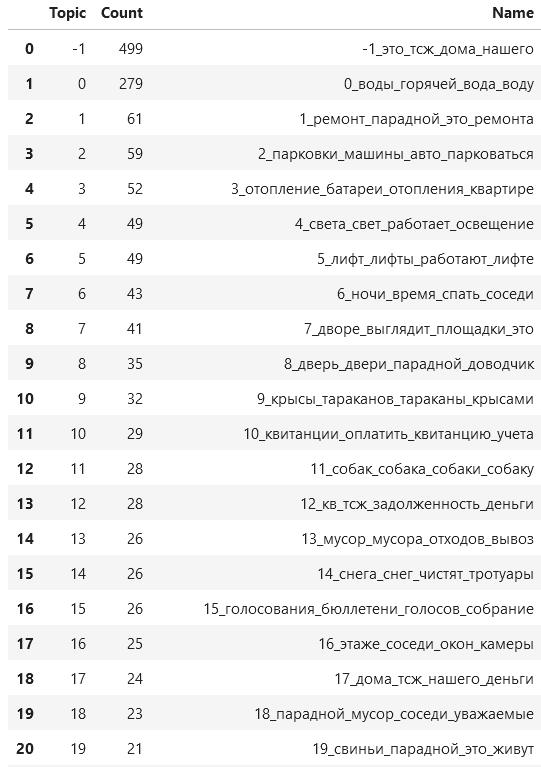

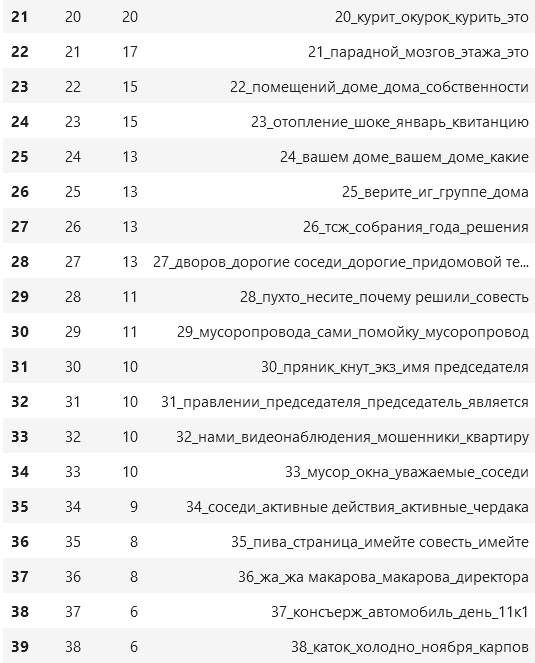

In [ ]:
###########################
# вот эти параметры регулируешь
posts_begin_date = '01.01.2019'
posts_end_date = '01.01.2020'

zakupki_begin_date = '01.01.2019'
zakupki_end_date = '01.01.2021'

# если False, то будет фильтровать по startExecutionDate (вроде это начало контракта),
# иначе по endExecutionDate (соответственно конец)
filter_end_execution_date = False

topic = 'all_posts_with_3'
show_all_posts = True
############################



date_format = '%d.%m.%Y'
posts_begin_date = datetime.strptime(posts_begin_date, date_format)
posts_end_date = datetime.strptime(posts_end_date, date_format)

zakupki_begin_date = datetime.strptime(zakupki_begin_date, date_format)
zakupki_end_date = datetime.strptime(zakupki_end_date, date_format)

if filter_end_execution_date:
    zakupki_date_col = 'endExecutionDate'
else:
    zakupki_date_col = 'startExecutionDate'

zakupki2_date_col = 'submissionCloseDateTime'

weights = np.load(f'weights/{topic}.npy')

if show_all_posts:
    posts_df_ = all_posts_df.copy()
else:
    posts_df_ = posts_df.copy()

posts_df_['weight'] = weights[with_lat_posts]
map_posts_df = posts_df_.copy()


posts_condition = (map_posts_df['date'] >= posts_begin_date) & (map_posts_df['date'] < posts_end_date)
zakupki_condition = (zakupki_df[zakupki_date_col] >= zakupki_begin_date) & (zakupki_df[zakupki_date_col] < zakupki_end_date)
zakupki2_condition = (zakupki2_df[zakupki2_date_col] >= zakupki_begin_date) & (zakupki2_df[zakupki2_date_col] < zakupki_end_date)

map_posts_df = map_posts_df[posts_condition]
map_zakupki_df = zakupki_df[zakupki_condition]
map_zakupki2_df = zakupki2_df[zakupki2_condition]

In [ ]:
def visualize_polygons(geometry):

    lats, lons = get_lat_lon(geometry)

    m = folium.Map(location=[sum(lats)/len(lats), sum(lons)/len(lons)], zoom_start=10, tiles='cartodbpositron')

    overlay = gpd.GeoSeries(geometry).to_json()
    folium.GeoJson(overlay, name = 'boundary').add_to(m)

    return m

# выводим центроиды полигонов
def get_lat_lon(geometry):

    lon = geometry.apply(lambda x: x.x if x.type == 'Point' else x.centroid.x)
    lat = geometry.apply(lambda x: x.y if x.type == 'Point' else x.centroid.y)
    return lat, lon

## Визуализация за определенный период

In [ ]:
cities = ['Санкт-Петербург']
polygon_krd = ox.geometries_from_place(cities, {'place':'city'}).reset_index()
polygon_krd = polygon_krd[(polygon_krd['osmid'] == 421007)]

m = visualize_polygons(polygon_krd['geometry'])

post_markercluster = MarkerCluster(control=False).add_to(m)

# add marker one by one on the map
for i in range(0, len(map_posts_df)):
    row = map_posts_df.iloc[i]
    html=f"""
        <h1>Сообщение №{row['num']}</h1>
        <p>ID группы: {row['owner_id']}</p>
        <p>Дата: {row['date']}</p>
        <p>Широта, долгота: {row['lat']}, {row['lon']}</p>
        <p>Вес: {row['weight']}</p>
        <p>Текст: {row['text']}</p>
        """
    iframe = folium.IFrame(html=html, width=200, height=200)
    icon=folium.Icon(color='orange')
    popup = folium.Popup(iframe, max_width=2650)
    folium.Marker(
        location=[row['lat_map'], row['lon']],
        popup=popup,
        icon=icon
    ).add_to(post_markercluster)


icon_create_function = '''
    function(cluster) {
    return L.divIcon({html: '<div><span>К' + cluster.getChildCount() + '</span></div>',
                      className: 'marker-cluster marker-cluster-small',
                      iconSize: new L.Point(40, 40)});
    }
'''

zakupka_markercluster = MarkerCluster(control=False, maxClusterRadius=2, icon_create_function=icon_create_function).add_to(m)

for i in range(0, len(map_zakupki_df)):
    row = map_zakupki_df.iloc[i]
    html=f"""
        <h1>Контракт {row['num']}</h1>
        <p>Дата начала контракта: {row['startExecutionDate']}</p>
        <p>Дата завершения контракта: {row['endExecutionDate']}</p>
        <p>Стоимость контракта: {row['price']}</p>
        <p>Текст: {row['subjectContract']}</p>
        """
    iframe = folium.IFrame(html=html, width=200, height=200)
    icon=folium.Icon(color='blue')
    popup = folium.Popup(iframe, max_width=2650)
    folium.Marker(
        location=[row['long'], row['lati']],
        popup=popup,
        icon=icon
    ).add_to(zakupka_markercluster)

for i in range(0, len(map_zakupki2_df)):
    row = map_zakupki2_df.iloc[i]
    html=f"""
        <h1>Заказ {row['num']}</h1>
        <p>Дата закрытия заказа: {row['submissionCloseDateTime']}</p>
        <p>Стоимость контракта: {row['initialSum']}</p>
        <p>Текст: {row['name']}</p>
        """
    iframe = folium.IFrame(html=html, width=200, height=200)
    icon=folium.Icon(color='blue')
    popup = folium.Popup(iframe, max_width=2650)
    folium.Marker(
        location=[row['lat'], row['lon']],
        popup=popup,
        icon=icon
    ).add_to(zakupka_markercluster)

# Show the map again
m

<ipython-input-11-67cca6c993df>:15: ShapelyDeprecationWarning: The 'type' attribute is deprecated, and will be removed in the future. You can use the 'geom_type' attribute instead.
  lon = geometry.apply(lambda x: x.x if x.type == 'Point' else x.centroid.x)
<ipython-input-11-67cca6c993df>:16: ShapelyDeprecationWarning: The 'type' attribute is deprecated, and will be removed in the future. You can use the 'geom_type' attribute instead.
  lat = geometry.apply(lambda x: x.y if x.type == 'Point' else x.centroid.y)


<frozen importlib._bootstrap>:914: ImportWarning: APICoreClientInfoImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _PyDriveImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _OpenCVImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _BokehImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _AltairImportHook.find_spec() not found; falling back to find_module()


## Визуализация за все года

In [ ]:
cities = ['Санкт-Петербург']
polygon_krd = ox.geometries_from_place(cities, {'place':'city'}).reset_index()
polygon_krd = polygon_krd[(polygon_krd['osmid'] == 421007)]

m = visualize_polygons(polygon_krd['geometry'])

post_markercluster = MarkerCluster(control=False, maxClusterRadius=2).add_to(m)

# add marker one by one on the map
for i in range(0, len(posts_df_)):
    row = posts_df_.iloc[i]
    html=f"""
        <h1>Сообщение №{row['num']}</h1>
        <p>ID группы: {row['owner_id']}</p>
        <p>Дата: {row['date']}</p>
        <p>Широта, долгота: {row['lat']}, {row['lon']}</p>
        <p>Вес: {row['weight']}</p>
        <p>Текст: {row['text']}</p>
        """
    iframe = folium.IFrame(html=html, width=200, height=200)
    icon=folium.Icon(color='orange')
    popup = folium.Popup(iframe, max_width=2650)
    folium.Marker(
        location=[row['lat_map'], row['lon']],
        popup=popup,
        icon=icon
    ).add_to(post_markercluster)


icon_create_function = '''
    function(cluster) {
    return L.divIcon({html: '<div><span>К' + cluster.getChildCount() + '</span></div>',
                      className: 'marker-cluster marker-cluster-small',
                      iconSize: new L.Point(40, 40)});
    }
'''

zakupka_markercluster = MarkerCluster(control=False, maxClusterRadius=2, icon_create_function=icon_create_function).add_to(m)

for i in range(0, len(zakupki_df)):
    row = zakupki_df.iloc[i]
    html=f"""
        <h1>Контракт {row['num']}</h1>
        <p>Дата начала контракта: {row['startExecutionDate']}</p>
        <p>Дата завершения контракта: {row['endExecutionDate']}</p>
        <p>Стоимость контракта: {row['price']}</p>
        <p>Текст: {row['subjectContract']}</p>
        """
    iframe = folium.IFrame(html=html, width=200, height=200)
    icon=folium.Icon(color='blue')
    popup = folium.Popup(iframe, max_width=2650)
    folium.Marker(
        location=[row['long'], row['lati']],
        popup=popup,
        icon=icon
    ).add_to(zakupka_markercluster)

for i in range(0, len(zakupki2_df)):
    row = zakupki2_df.iloc[i]
    html=f"""
        <h1>Заказ {row['num']}</h1>
        <p>Дата закрытия заказа: {row['submissionCloseDateTime']}</p>
        <p>Стоимость контракта: {row['initialSum']}</p>
        <p>Текст: {row['name']}</p>
        """
    iframe = folium.IFrame(html=html, width=200, height=200)
    icon=folium.Icon(color='blue')
    popup = folium.Popup(iframe, max_width=2650)
    folium.Marker(
        location=[row['lat'], row['lon']],
        popup=popup,
        icon=icon
    ).add_to(zakupka_markercluster)

# Show the map again
m

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
<ipython-input-11-67cca6c993df>:15: ShapelyDeprecationWarning: The 'type' attribute is deprecated, and will be removed in the future. You can use the 'geom_type' attribute instead.
  lon = geometry.apply(lambda x: x.x if x.type == 'Point' else x.centroid.x)
<ipython-input-11-67cca6c993df>:16: ShapelyDeprecationWarning: The 'type' attribute is deprecated, and will be removed in the future. You can use the 'geom_type' attribute instead.
  lat = geometry.apply(lambda x: x.y if x.type == 'Point' else x.centroid.y)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


# Нахожу близкие посты и контракты

ищутся близкие по геокоординатам и по времени (не больше года) закупки и посты в соцсетях

In [ ]:
posts_gdf_ = gpd.GeoDataFrame(posts_df_, geometry=gpd.points_from_xy(posts_df_['lon'], posts_df_['lat']))
zakupki_gdf = gpd.GeoDataFrame(zakupki_df, geometry=gpd.points_from_xy(zakupki_df['lati'], zakupki_df['long']))
zakupki2_gdf = gpd.GeoDataFrame(zakupki2_df, geometry=gpd.points_from_xy(zakupki2_df['lon'], zakupki2_df['lat']))

In [ ]:
closest = posts_gdf_.sjoin_nearest(zakupki_gdf, how='inner', max_distance=0.003, distance_col='distance')
closest = closest[(closest['endExecutionDate'] > closest['date']) & ((closest['endExecutionDate'] - closest['date']).dt.days < 365)]
print(len(closest))
closest.to_csv('closest_posts_and_zakupki.csv', sep='|', index=None)

642


In [ ]:
closest2 = posts_gdf_.sjoin_nearest(zakupki2_gdf, how='inner', max_distance=0.003, distance_col='distance')
closest2 = closest2[(closest2['submissionCloseDateTime'] > closest2['date']) & ((closest2['submissionCloseDateTime'] - closest2['date']).dt.days < 365)]
print(len(closest2))
closest2.to_csv('closest_posts_and_zakupki2.csv', sep='|', index=None)

155


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
